# Proyek Klasifikasi Gambar: [Food Image Classification Dataset](https://www.kaggle.com/datasets/harishkumardatalab/food-image-classification-dataset)
- **Nama:** Nafa Khairunnisa
- **Email:** nkhairunn2412@gmail.com
- **ID Dicoding:** nafa-khairunnisa

## Import Semua Packages/Library yang Digunakan

In [1]:
!pip install tensorflow

In [2]:
!pip install tensorflowjs

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 89.1/89.1 kB 2.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 53.0/53.0 kB 3.3 MB/s eta 0:00:00
  Attempting uninstall: packaging
    Found existing installation: packaging 24.2
    Uninstalling packaging-24.2:
      Successfully uninstalled packaging-24.2
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
google-cloud-bigquery 3.31.0 requires packaging>=24.2.0, but you have packaging 23.2 which is incompatible.


In [3]:
!pip install scikeras

In [43]:
# Library yang sering digunakan
import os, shutil
import zipfile
import random
from collections import defaultdict
from random import sample
from google.colab import files
from collections import Counter
from google.colab import files
import seaborn as sns
import numpy as np
import math
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import pandas as pd

In [5]:
# Libraries untuk pemrosesan data gambar
from PIL import Image
import skimage
from skimage import io
from PIL import Image, ImageOps
from tqdm import tqdm

In [47]:
# Libraries untuk pembangunan model
import keras
from keras.layers import TFSMLayer
from keras.applications import ResNet50
from scikeras.wrappers import KerasClassifier
from tensorflow.keras.applications.mobilenet_v2 import preprocess_input
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix, classification_report
import tensorflow as tf
from keras import regularizers
from sklearn.utils.class_weight import compute_class_weight
from tensorflow.keras import Model, layers
from tensorflow.keras.preprocessing import image
from tensorflow.keras.regularizers import l2
from tensorflow.keras.applications import MobileNetV2
from tensorflow.keras.layers import InputLayer
from keras import layers, models
from tensorflow.keras.preprocessing.image import ImageDataGenerator, img_to_array, load_img
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.layers import Input, Conv2D, MaxPooling2D, Dense, Flatten, Dropout, BatchNormalization, GlobalAveragePooling2D, UpSampling2D
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.callbacks import Callback, EarlyStopping, ModelCheckpoint, ReduceLROnPlateau
from sklearn.utils.class_weight import compute_class_weight

In [7]:
# Libraries untuk menyimpan model
import tensorflowjs as tfjs

In [8]:
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

In [9]:
!pip freeze > requirements.txt

## Data Preparation

### Data Loading

In [10]:
# Import module yang disediakan google colab untuk kebutuhan upload file

from google.colab import files
files.upload()

Saving kaggle.json to kaggle.json


{'kaggle.json': b'{"username":"nafakhairunnisa","key":"ecef6641399f01dc97f746571b937dc8"}'}

In [11]:
# Memindahkan ke folder .kaggle
!mkdir -p ~/.kaggle
!cp kaggle.json ~/.kaggle/

# Mengubah permission agar bisa digunakan oleh kaggle CLI
!chmod 600 ~/.kaggle/kaggle.json

# Download dataset dari Kaggle
!kaggle datasets download -d harishkumardatalab/food-image-classification-dataset

# Unzip file dataset
!unzip food-image-classification-dataset.zip

Output streaming akan dipotong hingga 5000 baris terakhir.
  inflating: Food Classification dataset/idli/277.jpg  
  inflating: Food Classification dataset/idli/278.jpg  
  inflating: Food Classification dataset/idli/280.jpg  
  inflating: Food Classification dataset/idli/282.jpg  
  inflating: Food Classification dataset/idli/283.jpg  
  inflating: Food Classification dataset/idli/284.jpg  
  inflating: Food Classification dataset/idli/285.jpg  
  inflating: Food Classification dataset/idli/286.jpg  
  inflating: Food Classification dataset/idli/287.jpg  
  inflating: Food Classification dataset/idli/288.jpg  
  inflating: Food Classification dataset/idli/290.jpg  
  inflating: Food Classification dataset/idli/292.jpg  
  inflating: Food Classification dataset/idli/293.jpg  
  inflating: Food Classification dataset/idli/295.jpg  
  inflating: Food Classification dataset/idli/296.jpg  
  inflating: Food Classification dataset/idli/297.jpg  
  inflating: Food Classification dataset/idli

### Dataset Checking

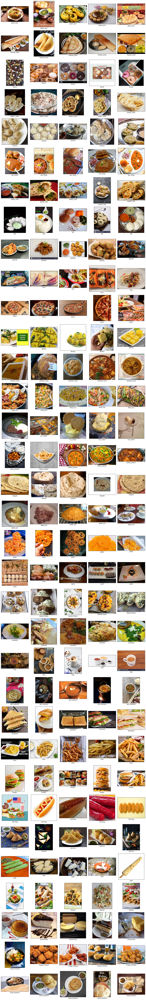

In [12]:
# Membuat kamus yang menyimpan gambar untuk setiap kelas dalam data
food_image = {}

# Tentukan path sumber train
path = "/content/Food Classification dataset"

# Membaca semua folder (label)
for i in os.listdir(path):
    folder_path = os.path.join(path, i)
    if os.path.isdir(folder_path):  # Pastikan hanya folder
        food_image[i] = os.listdir(folder_path)

# Menampilkan secara acak 5 gambar di bawah setiap dari 2 kelas dari data
fig, axs = plt.subplots(len(food_image.keys()), 5, figsize=(15, 3 * len(food_image)))

for i, class_name in enumerate(food_image.keys()):
    images = np.random.choice(food_image[class_name], 5, replace=False)

    for j, image_name in enumerate(images):
        img_path = os.path.join(path, class_name, image_name)
        img = Image.open(img_path).convert("RGB")  # Tetap berwarna
        axs[i, j].imshow(img)
        axs[i, j].set(xlabel=class_name, xticks=[], yticks=[])

fig.tight_layout()
plt.show()

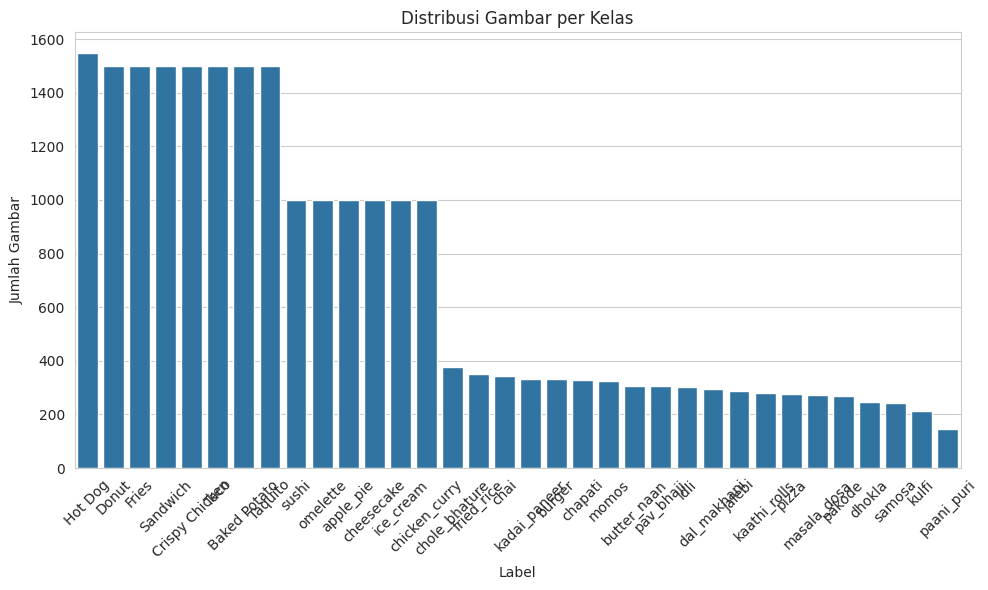

In [13]:
# List penampung data
file_name = []
labels = []
full_path = []

# Loop semua gambar dalam subfolder (label)
for path, subdirs, files in os.walk(path):
    for name in files:
        full_path.append(os.path.join(path, name))
        labels.append(os.path.basename(path))  # Nama folder sebagai label
        file_name.append(name)

# Buat DataFrame
distribution_food = pd.DataFrame({
    "path": full_path,
    "file_name": file_name,
    "labels": labels
})

# Plot distribusi gambar di setiap kelas
plt.figure(figsize=(10, 6))
sns.set_style("whitegrid")
sns.countplot(data=distribution_food, x='labels', order=distribution_food['labels'].value_counts().index)
plt.title("Distribusi Gambar per Kelas")
plt.xlabel("Label")
plt.ylabel("Jumlah Gambar")
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

### Pemilihan Data

In [14]:
# Cek jumlah gambar

# Path ke folder utama yang berisi subfolder label
main_folder = '/content/Food Classification dataset'

# Inisialisasi dictionary untuk simpan hasil
image_counts = {}

# Loop setiap subfolder (label)
for label_name in os.listdir(main_folder):
    label_path = os.path.join(main_folder, label_name)

    if os.path.isdir(label_path):
        # Filter hanya file gambar
        image_files = [
            f for f in os.listdir(label_path)
            if f.lower().endswith(('.jpg', '.jpeg', '.png'))
        ]
        image_counts[label_name] = len(image_files)

# Menampilkan jumlah gambar per label
for label, count in sorted(image_counts.items(), key=lambda x: x[0]):
    print(f"{label}: {count} gambar")

# Total gambar (opsional)
total_images = sum(image_counts.values())
print(f"\nTotal semua gambar: {total_images}")

Baked Potato: 1500 gambar
Crispy Chicken: 1500 gambar
Donut: 1500 gambar
Fries: 1500 gambar
Hot Dog: 1548 gambar
Sandwich: 1500 gambar
Taco: 1500 gambar
Taquito: 1500 gambar
apple_pie: 1000 gambar
burger: 331 gambar
butter_naan: 307 gambar
chai: 344 gambar
chapati: 327 gambar
cheesecake: 1000 gambar
chicken_curry: 1000 gambar
chole_bhature: 376 gambar
dal_makhani: 295 gambar
dhokla: 245 gambar
fried_rice: 350 gambar
ice_cream: 1000 gambar
idli: 302 gambar
jalebi: 288 gambar
kaathi_rolls: 279 gambar
kadai_paneer: 334 gambar
kulfi: 214 gambar
masala_dosa: 273 gambar
momos: 323 gambar
omelette: 1000 gambar
paani_puri: 144 gambar
pakode: 269 gambar
pav_bhaji: 305 gambar
pizza: 275 gambar
samosa: 244 gambar
sushi: 1000 gambar

Total semua gambar: 23873


In [15]:
# Mengambil 10 label dengan gambar terbanyak
top_10 = sorted(image_counts.items(), key=lambda x: x[1], reverse=True)[:10]

print("10 Label dengan jumlah gambar terbanyak:")
for label, count in top_10:
    print(f"{label}: {count} gambar")

10 Label dengan jumlah gambar terbanyak:
Hot Dog: 1548 gambar
Donut: 1500 gambar
Taco: 1500 gambar
Baked Potato: 1500 gambar
Sandwich: 1500 gambar
Fries: 1500 gambar
Taquito: 1500 gambar
Crispy Chicken: 1500 gambar
chicken_curry: 1000 gambar
ice_cream: 1000 gambar


Dataset yang diambil untuk train test split hanya 10 kelas yang memiliki gambar 1000 atau lebih. Sehingga yang diambil yaitu: Baked Potato, Crispy Chicken, Hot Dog, Taco, Sandwich, Taquito, Donut, Fries, ice_cream, dan chicken_curry.

In [16]:
# Label-label yang akan dipindahkan
top_labels = [
    "Hot Dog", "Baked Potato", "Crispy Chicken", "Donut", "Fries",
    "Sandwich", "Taco", "Taquito", "chicken_curry", "ice_cream"
]

# Folder asal dan tujuan
source_dir = "/content/Food Classification dataset"
destination_dir = "food_dataset"

# Membuat folder tujuan kalau belum ada
os.makedirs(destination_dir, exist_ok=True)

# Memindahkan tiap folder label ke folder food_dataset
for label in top_labels:
    src_path = os.path.join(source_dir, label)
    dst_path = os.path.join(destination_dir, label)

    if os.path.exists(src_path):
        shutil.copytree(src_path, dst_path)
        print(f"Folder '{label}' berhasil dipindahkan.")
    else:
        print(f"Folder '{label}' tidak ditemukan di {source_dir}.")

Folder 'Hot Dog' berhasil dipindahkan.
Folder 'Baked Potato' berhasil dipindahkan.
Folder 'Crispy Chicken' berhasil dipindahkan.
Folder 'Donut' berhasil dipindahkan.
Folder 'Fries' berhasil dipindahkan.
Folder 'Sandwich' berhasil dipindahkan.
Folder 'Taco' berhasil dipindahkan.
Folder 'Taquito' berhasil dipindahkan.
Folder 'chicken_curry' berhasil dipindahkan.
Folder 'ice_cream' berhasil dipindahkan.


### Undersampling Data

Pada tahapan ini, dataset dilakukan undersampling untuk mengambil 1000 data saja tiap label.

In [17]:
# Path dataset
food_path = "food_dataset/"

# Ambil semua file dan label
file_name = []
labels = []
full_path = []

for path, subdirs, files in os.walk(food_path):
    for name in files:
        full_path.append(os.path.join(path, name))
        labels.append(os.path.basename(path))
        file_name.append(name)

# Buat DataFrame awal
distribution_food = pd.DataFrame({
    "path": full_path,
    "file_name": file_name,
    "labels": labels
})

# Undersampling: ambil max 1000 gambar per kelas
balanced_df = (
    distribution_food.groupby('labels')
    .apply(lambda x: x.sample(n=1000, random_state=42) if len(x) >= 1000 else x)
    .reset_index(drop=True)
)

# Cek hasil distribusinya
print("Distribusi setelah undersampling:")
print(balanced_df['labels'].value_counts())

Distribusi setelah undersampling:
labels
Baked Potato      1000
Crispy Chicken    1000
Donut             1000
Fries             1000
Hot Dog           1000
Sandwich          1000
Taco              1000
Taquito           1000
chicken_curry     1000
ice_cream         1000
Name: count, dtype: int64


<ipython-input-17-051a6b8fe367>:25: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  .apply(lambda x: x.sample(n=1000, random_state=42) if len(x) >= 1000 else x)


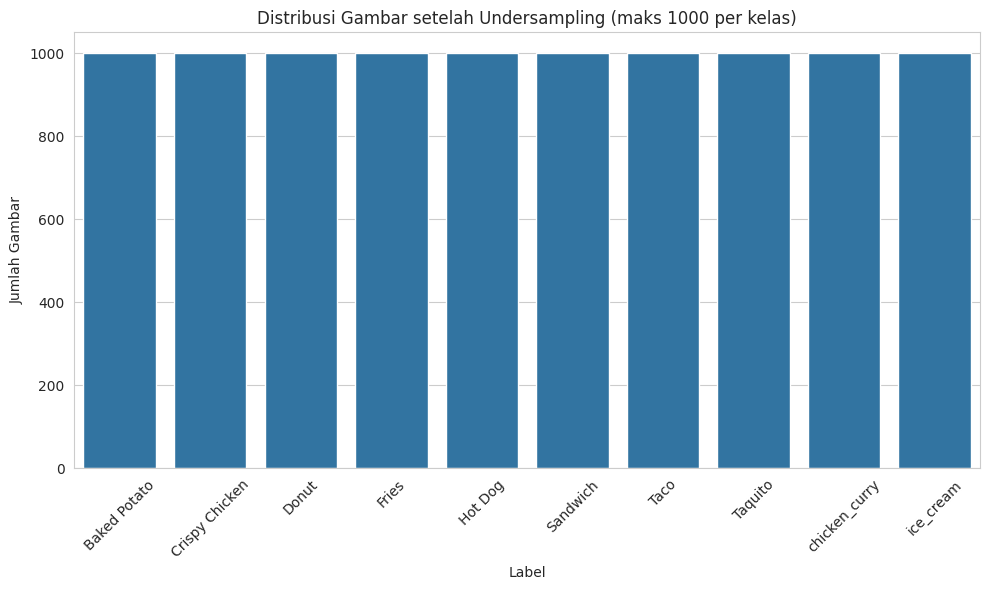

In [18]:
# Plot distribusi
plt.figure(figsize=(10, 6))
sns.countplot(data=balanced_df, x='labels', order=balanced_df['labels'].value_counts().index)
plt.title("Distribusi Gambar setelah Undersampling (maks 1000 per kelas)")
plt.xlabel("Label")
plt.ylabel("Jumlah Gambar")
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

### Data Preprocessing

#### Split Dataset

In [19]:
# Path awal
mypath = "food_dataset/"

# Kumpulkan semua path dan label
file_name = []
labels = []
full_path = []

for path, subdirs, files in os.walk(mypath):
    for name in files:
        full_path.append(os.path.join(path, name))
        labels.append(os.path.basename(path))
        file_name.append(name)

# Gunakan data yang sudah di-undersample
df = balanced_df.copy()

# Split tahap 1: train (70%) dan sisanya (30%)
X_train, X_temp, y_train, y_temp = train_test_split(
    df['path'], df['labels'], test_size=0.3, random_state=42, stratify=df['labels'])

# Split tahap 2: val (15%) dan test (15%)
X_val, X_test, y_val, y_test = train_test_split(
    X_temp, y_temp, test_size=0.5, random_state=42, stratify=y_temp)

# Buat DataFrame untuk masing-masing set
df_tr = pd.DataFrame({'path': X_train, 'labels': y_train, 'set': 'train'})
df_val = pd.DataFrame({'path': X_val, 'labels': y_val, 'set': 'val'})
df_te = pd.DataFrame({'path': X_test, 'labels': y_test, 'set': 'test'})

# Gabungkan semua
df_all = pd.concat([df_tr, df_val, df_te], ignore_index=True)

# Cek distribusi
print(df_all.groupby(['set', 'labels']).size())

set    labels        
test   Baked Potato      150
       Crispy Chicken    150
       Donut             150
       Fries             150
       Hot Dog           150
       Sandwich          150
       Taco              150
       Taquito           150
       chicken_curry     150
       ice_cream         150
train  Baked Potato      700
       Crispy Chicken    700
       Donut             700
       Fries             700
       Hot Dog           700
       Sandwich          700
       Taco              700
       Taquito           700
       chicken_curry     700
       ice_cream         700
val    Baked Potato      150
       Crispy Chicken    150
       Donut             150
       Fries             150
       Hot Dog           150
       Sandwich          150
       Taco              150
       Taquito           150
       chicken_curry     150
       ice_cream         150
dtype: int64


In [20]:
# Cek distribusi
print(df_all.groupby(['set', 'labels']).size())
print(df_all.sample(5))

set    labels        
test   Baked Potato      150
       Crispy Chicken    150
       Donut             150
       Fries             150
       Hot Dog           150
       Sandwich          150
       Taco              150
       Taquito           150
       chicken_curry     150
       ice_cream         150
train  Baked Potato      700
       Crispy Chicken    700
       Donut             700
       Fries             700
       Hot Dog           700
       Sandwich          700
       Taco              700
       Taquito           700
       chicken_curry     700
       ice_cream         700
val    Baked Potato      150
       Crispy Chicken    150
       Donut             150
       Fries             150
       Hot Dog           150
       Sandwich          150
       Taco              150
       Taquito           150
       chicken_curry     150
       ice_cream         150
dtype: int64
                                                   path          labels    set
6102  food_datas

In [21]:
# Menyimpan ke folder baru
dataset_path = "splitted_data_food/"

# Buat folder per kombinasi set dan label
for set_name in df_all['set'].unique():
    for label in df_all['labels'].unique():
        os.makedirs(os.path.join(dataset_path, set_name, label), exist_ok=True)

# Salin file satu per satu
for _, row in tqdm(df_all.iterrows(), total=len(df_all)):
    src = row['path']
    dst = os.path.join(dataset_path, row['set'], row['labels'], os.path.basename(row['path']))
    shutil.copy(src, dst)

100%|██████████| 10000/10000 [00:04<00:00, 2189.57it/s]


### Image Data Generator

In [22]:
# Direktori dataset
BASE_DIR = "splitted_data_food/"
TRAIN_DIR = os.path.join(BASE_DIR, "train")
VAL_DIR = os.path.join(BASE_DIR, "val")
TEST_DIR = os.path.join(BASE_DIR, "test")

SETS = ["train", "val", "test"]

# Fungsi bantu
def count_images(folder_path):
    return len(os.listdir(folder_path)) if os.path.exists(folder_path) else 0

# Ambil semua label dari direktori train
labels = sorted(os.listdir(os.path.join(BASE_DIR, "train")))

# Hitung jumlah gambar per label di setiap set
for set_name in SETS:
    print(f"\n=== {set_name.upper()} SET ===")
    for label in labels:
        folder_path = os.path.join(BASE_DIR, set_name, label)
        count = count_images(folder_path)
        print(f"{label}: {count} images")


=== TRAIN SET ===
Baked Potato: 700 images
Crispy Chicken: 700 images
Donut: 700 images
Fries: 700 images
Hot Dog: 700 images
Sandwich: 700 images
Taco: 700 images
Taquito: 700 images
chicken_curry: 700 images
ice_cream: 700 images

=== VAL SET ===
Baked Potato: 150 images
Crispy Chicken: 150 images
Donut: 150 images
Fries: 150 images
Hot Dog: 150 images
Sandwich: 150 images
Taco: 150 images
Taquito: 150 images
chicken_curry: 150 images
ice_cream: 150 images

=== TEST SET ===
Baked Potato: 150 images
Crispy Chicken: 150 images
Donut: 150 images
Fries: 150 images
Hot Dog: 150 images
Sandwich: 150 images
Taco: 150 images
Taquito: 150 images
chicken_curry: 150 images
ice_cream: 150 images


In [23]:
# Resize target
IMG_SIZE = (224, 224)
BATCH_SIZE = 64

# Data augmentation khusus untuk training
train_datagen = ImageDataGenerator(
    preprocessing_function=preprocess_input,  # WAJIB untuk MobileNetV2
    rotation_range=15,
    width_shift_range=0.1,
    height_shift_range=0.1,
    shear_range=0.1,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest'
)

# Untuk validation dan test tetap rescale saja (tanpa augmentasi)
test_val_datagen = ImageDataGenerator(preprocessing_function=preprocess_input)

# Generator untuk training
train_generator = train_datagen.flow_from_directory(
    TRAIN_DIR,
    target_size=IMG_SIZE,
    batch_size=BATCH_SIZE,
    class_mode='categorical',
    shuffle=True
)

# Generator untuk validation
validation_generator = test_val_datagen.flow_from_directory(
    VAL_DIR,
    target_size=IMG_SIZE,
    batch_size=BATCH_SIZE,
    class_mode='categorical',
    shuffle=False
)

# Generator untuk testing
test_generator = test_val_datagen.flow_from_directory(
    TEST_DIR,
    target_size=IMG_SIZE,
    batch_size=1,
    class_mode='categorical',
    shuffle=False
)

Found 7000 images belonging to 10 classes.
Found 1500 images belonging to 10 classes.
Found 1500 images belonging to 10 classes.


## Modelling

### Pembangunan model

In [24]:
# Ukuran input sesuai MobileNetV2
input_shape = (224, 224, 3)

# Transfer Learning Base (tanpa top layer)
base_model = MobileNetV2(input_shape=input_shape, include_top=False, weights='imagenet')
base_model.trainable = False  # Freeze semua layer MobileNetV2

# Freeze sebagian besar layer MobileNet
for layer in base_model.layers[:-50]:
    layer.trainable = False  # Membekukan sebagian besar layer

for layer in base_model.layers[-50:]:
    layer.trainable = True   # Mengaktfikan 50 layer terakhir

# Model Sequential gabungin dengan Conv2D & Pooling layer tambahan
model = Sequential([
    tf.keras.layers.Input(shape=input_shape),

    # Pre-trained MobileNetV2
    base_model,

    # Upsampling biar output dari MobileNetV2 gak terlalu kecil
    UpSampling2D(size=(2, 2)),

    # Extra conv layer kesatu
    Conv2D(32, (3,3), activation='relu', padding='same'),
    MaxPooling2D(pool_size=(2,2)),

    # Extra conv layer kedua
    Conv2D(64, (3, 3), activation='relu', padding='same'),
    MaxPooling2D(pool_size=(2, 2)),

    # Extra conv layer ketiga
    Conv2D(128, (3, 3), activation='relu', padding='same'),
    MaxPooling2D(pool_size=(2, 2)),

    # Global Average Pooling dari MobileNetV2
    GlobalAveragePooling2D(),

    Dropout(0.3),
    Dense(128, activation='relu', kernel_regularizer=regularizers.l2(0.001)),
    Dropout(0.2),
    Dense(10, activation='softmax')
])

# Compile
model.compile(optimizer=Adam(learning_rate=0.0001), loss='categorical_crossentropy', metrics=['accuracy'])
model.summary()

9406464/9406464 ━━━━━━━━━━━━━━━━━━━━ 2s 0us/step


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ mobilenetv2_1.00_224            │ (None, 7, 7, 1280)     │     2,257,984 │
│ (Functional)                    │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ up_sampling2d (UpSampling2D)    │ (None, 14, 14, 1280)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d (Conv2D)                 │ (None, 14, 14, 32)     │       368,672 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 7, 7, 32)       │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 7, 7, 64)       │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_1 (MaxPooling2D)  │ (None, 3, 3, 64)       │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_2 (Conv2D)               │ (None, 3, 3, 128)      │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_2 (MaxPooling2D)  │ (None, 1, 1, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling2d        │ (None, 128)            │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 128)            │        16,512 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 128)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 10)             │         1,290 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 2,736,810 (10.44 MB)

 Trainable params: 2,333,930 (8.90 MB)

 Non-trainable params: 402,880 (1.54 MB)

### Class Weight

Perhitungan class weight dilakukan untuk menghindari bias terhadap data yang dominan pada dataset train.

In [25]:
# Mengambil daftar kelas dari class_indices
classes = list(train_generator.class_indices.keys())

# Menghitung distribusi gambar untuk masing-masing label
labels = []
for i, class_name in enumerate(classes):
    class_path = os.path.join(TRAIN_DIR, class_name)
    num_images = len(os.listdir(class_path))
    labels.extend([i] * num_images)  # label numerik

# Menghitung class weights
class_weights_array = compute_class_weight(
    class_weight='balanced',
    classes=np.unique(labels),
    y=labels
)
class_weights = {i: weight for i, weight in enumerate(class_weights_array)}

print("Class Weights:", class_weights)

Class Weights: {0: np.float64(1.0), 1: np.float64(1.0), 2: np.float64(1.0), 3: np.float64(1.0), 4: np.float64(1.0), 5: np.float64(1.0), 6: np.float64(1.0), 7: np.float64(1.0), 8: np.float64(1.0), 9: np.float64(1.0)}


### Callbacks

In [56]:
# Callback
callbacks = [
    EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True, verbose=1),
    ModelCheckpoint('best_model.h5', save_best_only=True, monitor='val_loss', verbose=1),
    ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=3, min_lr=1e-6, verbose=1)
]

### Training Model

In [27]:
# Menentukan batch size
batch_size = 32

# Training model
history = model.fit(
    train_generator,
    steps_per_epoch=len(train_generator),
    epochs=30,
    validation_data=validation_generator,
    validation_steps=len(validation_generator),
    callbacks=callbacks
)

/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/30
 13/110 ━━━━━━━━━━━━━━━━━━━━ 1:17 794ms/step - accuracy: 0.1081 - loss: 2.8558

/usr/local/lib/python3.11/dist-packages/PIL/Image.py:1045: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


110/110 ━━━━━━━━━━━━━━━━━━━━ 0s 908ms/step - accuracy: 0.1833 - loss: 2.4249
Epoch 1: val_loss improved from inf to 1.61804, saving model to best_model.h5


110/110 ━━━━━━━━━━━━━━━━━━━━ 167s 1s/step - accuracy: 0.1844 - loss: 2.4220 - val_accuracy: 0.5120 - val_loss: 1.6180 - learning_rate: 1.0000e-04
Epoch 2/30
110/110 ━━━━━━━━━━━━━━━━━━━━ 0s 824ms/step - accuracy: 0.6326 - loss: 1.2187
Epoch 2: val_loss improved from 1.61804 to 1.61262, saving model to best_model.h5


110/110 ━━━━━━━━━━━━━━━━━━━━ 96s 873ms/step - accuracy: 0.6330 - loss: 1.2176 - val_accuracy: 0.6093 - val_loss: 1.6126 - learning_rate: 1.0000e-04
Epoch 3/30
110/110 ━━━━━━━━━━━━━━━━━━━━ 0s 819ms/step - accuracy: 0.8068 - loss: 0.7530
Epoch 3: val_loss improved from 1.61262 to 1.24116, saving model to best_model.h5


110/110 ━━━━━━━━━━━━━━━━━━━━ 95s 861ms/step - accuracy: 0.8068 - loss: 0.7528 - val_accuracy: 0.6967 - val_loss: 1.2412 - learning_rate: 1.0000e-04
Epoch 4/30
110/110 ━━━━━━━━━━━━━━━━━━━━ 0s 829ms/step - accuracy: 0.8651 - loss: 0.5704
Epoch 4: val_loss improved from 1.24116 to 1.00256, saving model to best_model.h5


110/110 ━━━━━━━━━━━━━━━━━━━━ 143s 867ms/step - accuracy: 0.8651 - loss: 0.5705 - val_accuracy: 0.7573 - val_loss: 1.0026 - learning_rate: 1.0000e-04
Epoch 5/30
110/110 ━━━━━━━━━━━━━━━━━━━━ 0s 796ms/step - accuracy: 0.8906 - loss: 0.5184
Epoch 5: val_loss improved from 1.00256 to 0.98968, saving model to best_model.h5


110/110 ━━━━━━━━━━━━━━━━━━━━ 93s 843ms/step - accuracy: 0.8907 - loss: 0.5181 - val_accuracy: 0.7760 - val_loss: 0.9897 - learning_rate: 1.0000e-04
Epoch 6/30
110/110 ━━━━━━━━━━━━━━━━━━━━ 0s 812ms/step - accuracy: 0.9188 - loss: 0.3971
Epoch 6: val_loss improved from 0.98968 to 0.97186, saving model to best_model.h5


110/110 ━━━━━━━━━━━━━━━━━━━━ 144s 864ms/step - accuracy: 0.9188 - loss: 0.3972 - val_accuracy: 0.8033 - val_loss: 0.9719 - learning_rate: 1.0000e-04
Epoch 7/30
110/110 ━━━━━━━━━━━━━━━━━━━━ 0s 803ms/step - accuracy: 0.9311 - loss: 0.3511
Epoch 7: val_loss did not improve from 0.97186
110/110 ━━━━━━━━━━━━━━━━━━━━ 139s 836ms/step - accuracy: 0.9311 - loss: 0.3511 - val_accuracy: 0.8047 - val_loss: 1.0026 - learning_rate: 1.0000e-04
Epoch 8/30
110/110 ━━━━━━━━━━━━━━━━━━━━ 0s 831ms/step - accuracy: 0.9383 - loss: 0.3155
Epoch 8: val_loss improved from 0.97186 to 0.84464, saving model to best_model.h5


110/110 ━━━━━━━━━━━━━━━━━━━━ 95s 867ms/step - accuracy: 0.9383 - loss: 0.3156 - val_accuracy: 0.8307 - val_loss: 0.8446 - learning_rate: 1.0000e-04
Epoch 9/30
110/110 ━━━━━━━━━━━━━━━━━━━━ 0s 804ms/step - accuracy: 0.9450 - loss: 0.2981
Epoch 9: val_loss improved from 0.84464 to 0.75151, saving model to best_model.h5


110/110 ━━━━━━━━━━━━━━━━━━━━ 94s 855ms/step - accuracy: 0.9451 - loss: 0.2981 - val_accuracy: 0.8473 - val_loss: 0.7515 - learning_rate: 1.0000e-04
Epoch 10/30
110/110 ━━━━━━━━━━━━━━━━━━━━ 0s 788ms/step - accuracy: 0.9584 - loss: 0.2609
Epoch 10: val_loss did not improve from 0.75151
110/110 ━━━━━━━━━━━━━━━━━━━━ 91s 825ms/step - accuracy: 0.9584 - loss: 0.2609 - val_accuracy: 0.8400 - val_loss: 0.8285 - learning_rate: 1.0000e-04
Epoch 11/30
110/110 ━━━━━━━━━━━━━━━━━━━━ 0s 787ms/step - accuracy: 0.9650 - loss: 0.2355
Epoch 11: val_loss did not improve from 0.75151
110/110 ━━━━━━━━━━━━━━━━━━━━ 90s 821ms/step - accuracy: 0.9650 - loss: 0.2355 - val_accuracy: 0.8347 - val_loss: 0.8983 - learning_rate: 1.0000e-04
Epoch 12/30
110/110 ━━━━━━━━━━━━━━━━━━━━ 0s 784ms/step - accuracy: 0.9657 - loss: 0.2187
Epoch 12: val_loss did not improve from 0.75151

Epoch 12: ReduceLROnPlateau reducing learning rate to 4.999999873689376e-05.
110/110 ━━━━━━━━━━━━━━━━━━━━ 142s 818ms/step - accuracy: 0.9657 - l

## Evaluasi dan Visualisasi

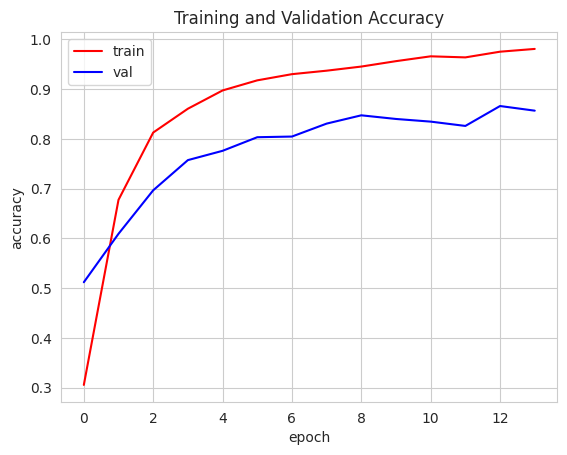

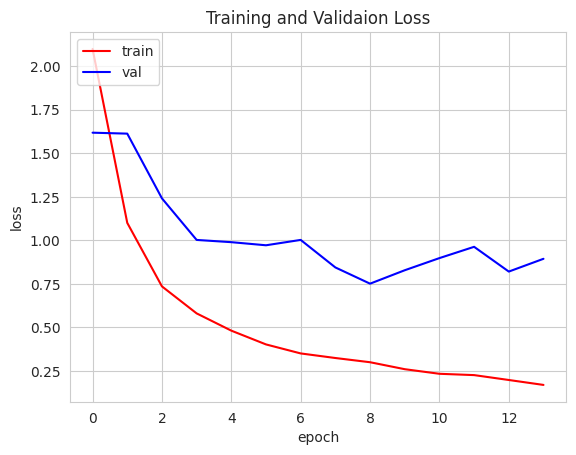

In [28]:
# Mengecek akurasi dan loss validation
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']
loss = history.history['loss']
val_loss = history.history['val_loss']

epochs = range(len(acc))

# Plot akurasi training dan validation
plt.plot(epochs, acc, 'r')
plt.plot(epochs, val_acc, 'b')
plt.title('Training and Validation Accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

# Plot loss training dan validation
plt.plot(epochs, loss, 'r')
plt.plot(epochs, val_loss, 'b')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.title('Training and Validaion Loss')
plt.show()

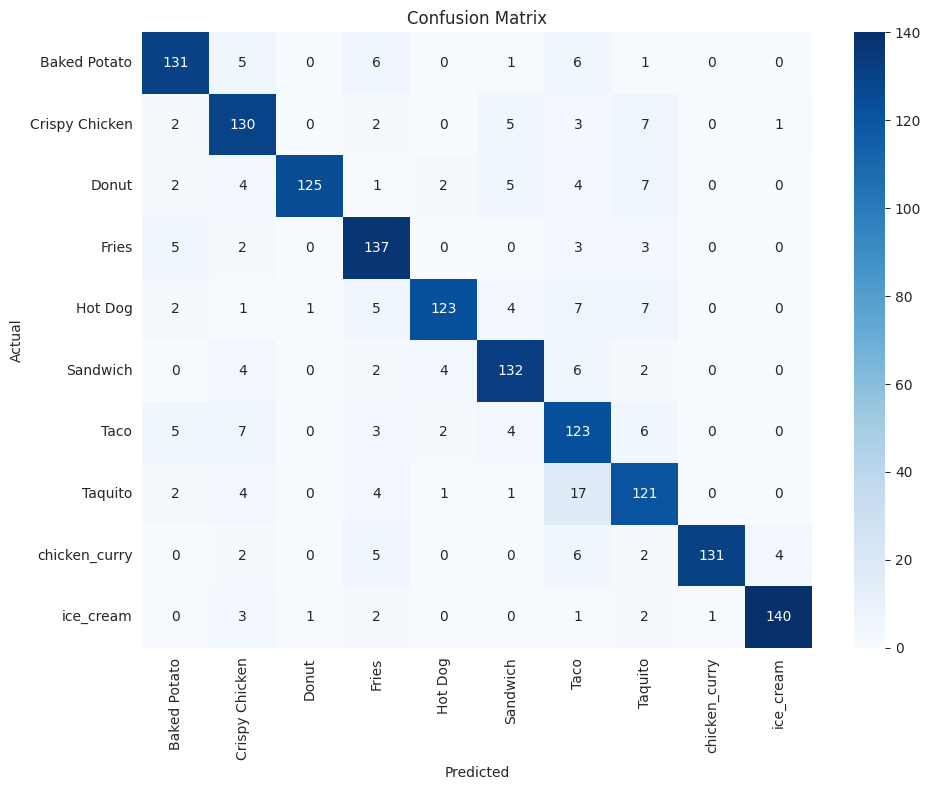

In [29]:
# Reset generator
test_generator.reset()

# Prediksi probabilitas
preds_probs = model.predict(test_generator, verbose=0)

# Mengambil prediksi kelas dari probabilitas
preds_labels = np.argmax(preds_probs, axis=1)

# Mengambil label asli
true_labels = test_generator.classes

# Mengambil nama kelas (dari direktori)
class_names = list(test_generator.class_indices.keys())

# Confusion Matrix
cm = confusion_matrix(true_labels, preds_labels)

# Plot Confusion Matrix
plt.figure(figsize=(10, 8))
sns.heatmap(pd.DataFrame(cm, index=class_names, columns=class_names),
            annot=True, fmt='d', cmap='Blues')
plt.xlabel("Predicted")
plt.ylabel("Actual")
plt.title("Confusion Matrix")
plt.tight_layout()
plt.show()

In [30]:
# Classification Report
print("\nClassification Report:\n")
print(classification_report(true_labels, preds_labels, target_names=class_names, digits=4))


Classification Report:

                precision    recall  f1-score   support

  Baked Potato     0.8792    0.8733    0.8763       150
Crispy Chicken     0.8025    0.8667    0.8333       150
         Donut     0.9843    0.8333    0.9025       150
         Fries     0.8204    0.9133    0.8644       150
       Hot Dog     0.9318    0.8200    0.8723       150
      Sandwich     0.8684    0.8800    0.8742       150
          Taco     0.6989    0.8200    0.7546       150
       Taquito     0.7658    0.8067    0.7857       150
 chicken_curry     0.9924    0.8733    0.9291       150
     ice_cream     0.9655    0.9333    0.9492       150

      accuracy                         0.8620      1500
     macro avg     0.8709    0.8620    0.8642      1500
  weighted avg     0.8709    0.8620    0.8642      1500



## Konversi Model

### SavedModel

In [32]:
# Menyimpan model ke format SavedModel
model.export("saved_model")

Saved artifact at 'saved_model'. The following endpoints are available:

* Endpoint 'serve'
  args_0 (POSITIONAL_ONLY): TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name='keras_tensor_154')
Output Type:
  TensorSpec(shape=(None, 10), dtype=tf.float32, name=None)
Captures:
  132997330043152: TensorSpec(shape=(), dtype=tf.resource, name=None)
  132997330051024: TensorSpec(shape=(), dtype=tf.resource, name=None)
  132997330053136: TensorSpec(shape=(), dtype=tf.resource, name=None)
  132997330053328: TensorSpec(shape=(), dtype=tf.resource, name=None)
  132997330051600: TensorSpec(shape=(), dtype=tf.resource, name=None)
  132997330049296: TensorSpec(shape=(), dtype=tf.resource, name=None)
  132997330051216: TensorSpec(shape=(), dtype=tf.resource, name=None)
  132997330052176: TensorSpec(shape=(), dtype=tf.resource, name=None)
  132997330047184: TensorSpec(shape=(), dtype=tf.resource, name=None)
  132997330052752: TensorSpec(shape=(), dtype=tf.resource, name=None)
  13299733004968

### TF-Lite

In [33]:
# Konversi model ke format TF-Lite
converter = tf.lite.TFLiteConverter.from_keras_model(model)
tflite_model = converter.convert()

# Simpan model TF-Lite ke file
with open('model.tflite', 'wb') as f:
    f.write(tflite_model)

Saved artifact at '/tmp/tmpsbps_ey4'. The following endpoints are available:

* Endpoint 'serve'
  args_0 (POSITIONAL_ONLY): TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name='keras_tensor_154')
Output Type:
  TensorSpec(shape=(None, 10), dtype=tf.float32, name=None)
Captures:
  132997330043152: TensorSpec(shape=(), dtype=tf.resource, name=None)
  132997330051024: TensorSpec(shape=(), dtype=tf.resource, name=None)
  132997330053136: TensorSpec(shape=(), dtype=tf.resource, name=None)
  132997330053328: TensorSpec(shape=(), dtype=tf.resource, name=None)
  132997330051600: TensorSpec(shape=(), dtype=tf.resource, name=None)
  132997330049296: TensorSpec(shape=(), dtype=tf.resource, name=None)
  132997330051216: TensorSpec(shape=(), dtype=tf.resource, name=None)
  132997330052176: TensorSpec(shape=(), dtype=tf.resource, name=None)
  132997330047184: TensorSpec(shape=(), dtype=tf.resource, name=None)
  132997330052752: TensorSpec(shape=(), dtype=tf.resource, name=None)
  132997330

In [34]:
# Membuat label.txt
with open("label.txt", "w") as f:
    for label in train_generator.class_indices.keys():
        f.write(label + "\n")

### Tensorflow.js (TFJS)

In [40]:
# Simpan model
model.save("model.h5")

In [41]:
# Konversi ke format TensorFlow.js
!tensorflowjs_converter --input_format=keras model.h5 tfjs_model/

2025-04-22 03:30:26.224961: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1745292626.244447   19424 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1745292626.250599   19424 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
🌲 Try https://ydf.readthedocs.io, the successor of TensorFlow Decision Forests with more features and faster training!
failed to lookup keras version from the file,
    this is likely a weight only file


## Inference (Optional)

Inference ini dilakukan dengan SavedModel menggunakan gambar baru yang diambil dari web Unsplash.

Photo by Joyce Panda on [Unsplash](https://unsplash.com/photos/french-fries-on-white-ceramic-plate-lpsbMRRqMQw?utm_content=creditShareLink&utm_medium=referral&utm_source=unsplash).

In [44]:
# Mengupload gambar baru
uploaded = files.upload()

Saving joyce-panda-lpsbMRRqMQw-unsplash.jpg to joyce-panda-lpsbMRRqMQw-unsplash.jpg


In [51]:
!ls saved_model

assets	fingerprint.pb	saved_model.pb	variables


In [50]:
# Memuat model SavedModel
loaded_model = TFSMLayer("saved_model", call_endpoint="serving_default")

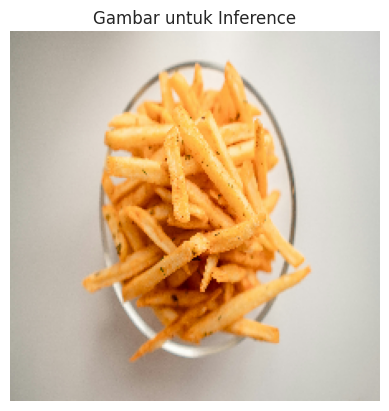

In [53]:
# Mengganti 'namafile.jpg' dengan nama file hasil upload (cek output files.upload())
img_path = list(uploaded.keys())[0]

# Menyamakan Ttrget size harus sama seperti yang dipakai saat training (150x150)
img = image.load_img(img_path, target_size=(224, 224))

# Preprocessing
img_array = image.img_to_array(img)
img_array = img_array / 255.0  # Normalisasi
img_array = np.expand_dims(img_array, axis=0)  # (1, 224, 224, 3)

# Plot gambar
plt.imshow(img_array.squeeze(), cmap='gray')
plt.title("Gambar untuk Inference")
plt.axis('off')
plt.show()

In [54]:
# Prediksi
pred = model.predict(img_array)

# Mengambil label kelas dari train generator
class_labels = list(train_generator.class_indices.keys())

# Menentukan kelas yang diprediksi
if pred.shape[1] == 1:  # binary classification
    pred_label = 1 if pred[0][0] > 0.5 else 0
else:  # multiclass classification
    pred_label = np.argmax(pred)

# Menampilkan hasil
print("Prediksi kelas (index):", pred_label)
print("Prediksi kelas (label):", class_labels[pred_label])

1/1 ━━━━━━━━━━━━━━━━━━━━ 5s 5s/step
Prediksi kelas (index): 3
Prediksi kelas (label): Fries


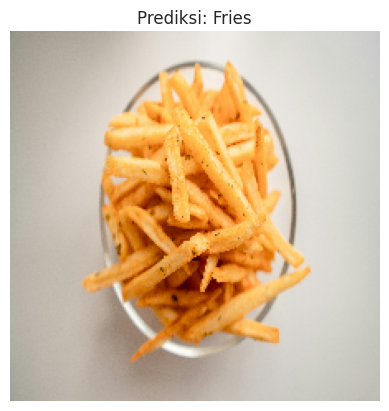

In [55]:
# Visualisasi gambar dan prediksi
plt.imshow(img)
plt.title(f"Prediksi: {class_labels[pred_label]}")
plt.axis('off')
plt.show()